# Exploring Dandiset 001366: Comparison of Approaches for Surface Vessel Diameter and Pulsatility Quantification

> **Note**: This notebook was generated with the assistance of AI. Please be cautious when interpreting the code or results and verify outputs independently.

## Overview

This notebook explores [Dandiset 001366](https://dandiarchive.org/dandiset/001366/0.250324.1603), which contains data for comparing different approaches to quantify surface vessel diameter and pulsatility in mice. The dataset consists of grayscale movies of pial vessels in mice, collected to analyze vessel dynamics.

In this notebook, we will:
1. Retrieve and examine the metadata of the Dandiset
2. List and explore the available NWB files
3. Load and visualize image data from one of the NWB files
4. Analyze vessel properties by examining the image time series

## Required Packages

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import pynwb
import h5py
import remfile
from dandi.dandiapi import DandiAPIClient

## Exploring the Dandiset Metadata

In [2]:
# Initialize DANDI API client and retrieve the Dandiset
client = DandiAPIClient()
dandiset = client.get_dandiset("001366", "0.250324.1603")
metadata = dandiset.get_raw_metadata()

# Print basic information about the Dandiset
print(f"Dandiset name: {metadata['name']}")
print(f"Dandiset URL: {metadata['url']}")
print(f"Dandiset DOI: {metadata['doi']}")
print(f"Version: {metadata['version']}")
print(f"Description: {metadata['description']}")
print(f"Keywords: {', '.join(metadata['keywords'])}")

Dandiset name: Comparison of Approaches for Surface Vessel Diameter and Pulsatility Quantification
Dandiset URL: https://dandiarchive.org/dandiset/001366/0.250324.1603
Dandiset DOI: 10.48324/dandi.001366/0.250324.1603
Version: 0.250324.1603
Description: movies of a pial vessel of mice used in the experiments.
Keywords: full width at half maximum, vessel pulsation, image analysis, vessel diameter, radon transform


## Exploring Files in the Dandiset

In [3]:
# List all assets in the Dandiset
assets = list(dandiset.get_assets())
print(f"Total number of assets: {len(assets)}")

# Display basic information about each asset
for i, asset in enumerate(assets):
    print(f"\nAsset {i+1}:")
    print(f"  Path: {asset.path}")
    print(f"  Size: {asset.size / (1024*1024):.2f} MB")

Total number of assets: 2

Asset 1:
  Path: sub-F15/sub-F15_ses-F15BC-19102023_image.nwb
  Size: 389.19 MB

Asset 2:
  Path: sub-031224-M4/sub-031224-M4_ses-03122024-m4-baseline_image.nwb
  Size: 2267.67 MB


## Loading Data from an NWB File

Let's examine one of the NWB files containing vessel imaging data. We'll load the file via streaming without downloading it.

In [4]:
# Get the first NWB file
file_path = "sub-F15/sub-F15_ses-F15BC-19102023_image.nwb"
asset = next(dandiset.get_assets_by_glob(file_path))
url = asset.download_url

# Open the file for remote access
remote_file = remfile.File(url)
h5_file = h5py.File(remote_file)
io = pynwb.NWBHDF5IO(file=h5_file)
nwb = io.read()

/opt/conda/lib/python3.11/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-common' version 1.5.0 because version 1.8.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/opt/conda/lib/python3.11/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/opt/conda/lib/python3.11/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'hdmf-experimental' version 0.1.0 because version 0.5.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


## Examining NWB File Metadata

In [5]:
# Display basic metadata about the NWB file
print(f"Session ID: {nwb.session_id}")
print(f"Experiment description: {nwb.experiment_description}")
print(f"Session description: {nwb.session_description[:100]}...")  # Truncate for readability
print(f"Session start time: {nwb.session_start_time}")
print(f"Experimenter: {', '.join(nwb.experimenter)}")
print(f"Institution: {nwb.institution}")

Session ID: F15BC-19102023
Experiment description: Vessel diameter and pulsatility measurement.
Session description: a wild-type mouse skull was thinned at the area of the middle cerebral artery (MCA) and fitted with ...
Session start time: 2023-10-19 02:00:00-04:00
Experimenter: Ghanizada, Hashmat 
Institution: University of Copenhagen


## Subject Information

In [6]:
# Display information about the subject
subject = nwb.subject
print(f"Subject ID: {subject.subject_id}")
print(f"Age: {subject.age}")
print(f"Age reference: {subject.age__reference}")
print(f"Sex: {subject.sex}")
print(f"Species: {subject.species}")
print(f"Strain: {subject.strain}")
print(f"Description: {subject.description}")

Subject ID: F15
Age: P9W/P16W
Age reference: birth
Sex: F
Species: Mus musculus
Strain: C57BL/6J
Description: wild-type mouse


## Exploring the Image Data

The NWB file contains grayscale movies of pial vessels. Let's examine the image data to understand its dimensions and properties.

In [7]:
# Access the ImageSeries data containing the vessel movies
movie_data = nwb.acquisition["Movies"]

# Print information about the movie
print(f"Movie dimensions: {movie_data.data.shape}")
print(f"Data type: {movie_data.data.dtype}")
print(f"Frame rate: {movie_data.rate} fps")
print(f"Description: {movie_data.description}")
print(f"Unit: {movie_data.unit}")

Movie dimensions: (9553, 214, 132)
Data type: uint16
Frame rate: 54.47 fps
Description: 16-bit grayscale movie of a pial vessel
Unit: n.a.


The movie consists of 9,553 frames, each with a resolution of 214×132 pixels. The data is captured at approximately 54.47 frames per second.

## Visualizing the Vessel Data

Let's visualize some frames from the vessel movie to understand the pial vessel structure.

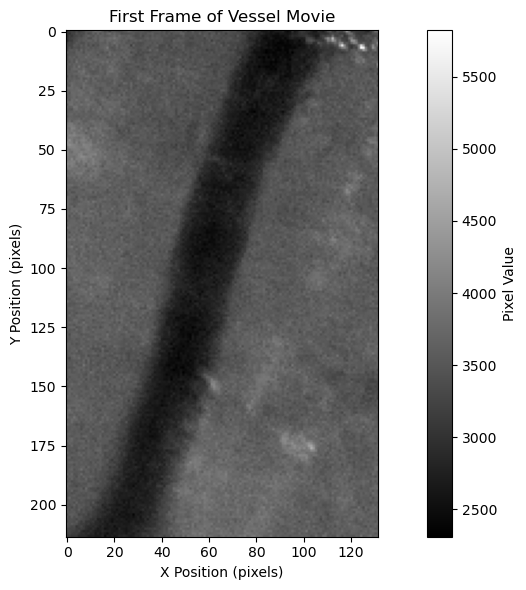

In [8]:
# Load a sample frame from the movie
sample_frame = movie_data.data[0, :, :]

# Display the first frame
plt.figure(figsize=(10, 6))
plt.imshow(sample_frame, cmap='gray')
plt.colorbar(label='Pixel Value')
plt.title('First Frame of Vessel Movie')
plt.xlabel('X Position (pixels)')
plt.ylabel('Y Position (pixels)')
plt.tight_layout()
plt.show()

The image shows a cross-section of a pial vessel. The vessel appears as a darker region against a lighter background.

## Visualizing Multiple Frames to Understand Changes Over Time

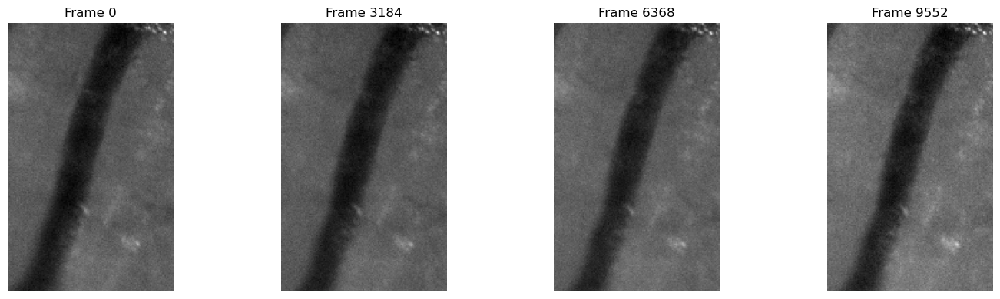

In [9]:
# Sample several frames at regular intervals to see changes over time
num_samples = 4
sample_indices = np.linspace(0, movie_data.data.shape[0]-1, num_samples, dtype=int)

plt.figure(figsize=(15, 4))
for i, idx in enumerate(sample_indices):
    plt.subplot(1, num_samples, i+1)
    plt.imshow(movie_data.data[idx, :, :], cmap='gray')
    plt.title(f'Frame {idx}')
    plt.axis('off')
plt.tight_layout()
plt.show()

These frames show the vessel at different time points. The vessel diameter and appearance may change slightly over time due to pulsatility.

## Creating a Time Series Plot of Pixel Intensity

To better visualize the vessel pulsation, let's examine the pixel intensity at a fixed position over time.

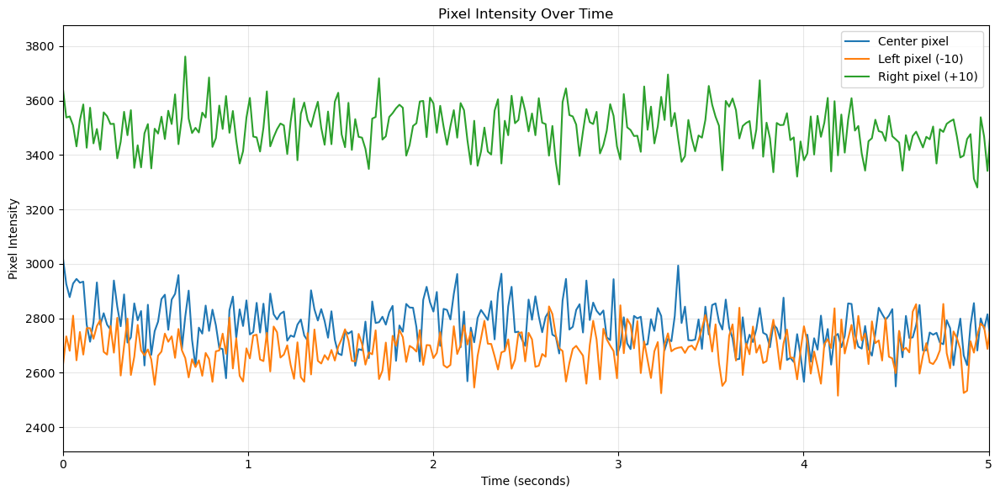

In [10]:
# Select the middle of the image for our intensity analysis
mid_row = movie_data.data.shape[1] // 2
mid_col = movie_data.data.shape[2] // 2

# Extract time series for the center pixel and nearby pixels
center_intensity = movie_data.data[:, mid_row, mid_col]
left_intensity = movie_data.data[:, mid_row, mid_col - 10] if mid_col >= 10 else movie_data.data[:, mid_row, 0]
right_intensity = movie_data.data[:, mid_row, mid_col + 10] if mid_col + 10 < movie_data.data.shape[2] else movie_data.data[:, mid_row, -1]

# Create a time axis (in seconds)
time_axis = np.arange(len(center_intensity)) / movie_data.rate

# Plot the intensity over time
plt.figure(figsize=(12, 6))
plt.plot(time_axis, center_intensity, label='Center pixel')
plt.plot(time_axis, left_intensity, label='Left pixel (-10)')
plt.plot(time_axis, right_intensity, label='Right pixel (+10)')
plt.xlabel('Time (seconds)')
plt.ylabel('Pixel Intensity')
plt.title('Pixel Intensity Over Time')
plt.legend()
plt.grid(True, alpha=0.3)

# For better visualization, show only the first 5 seconds
plt.xlim(0, 5)
plt.tight_layout()
plt.show()

This plot shows how the pixel intensity at selected points changes over time. Fluctuations in intensity can correspond to vessel pulsations and blood flow dynamics.

## Creating a Space-Time Plot to Visualize Vessel Diameter Changes

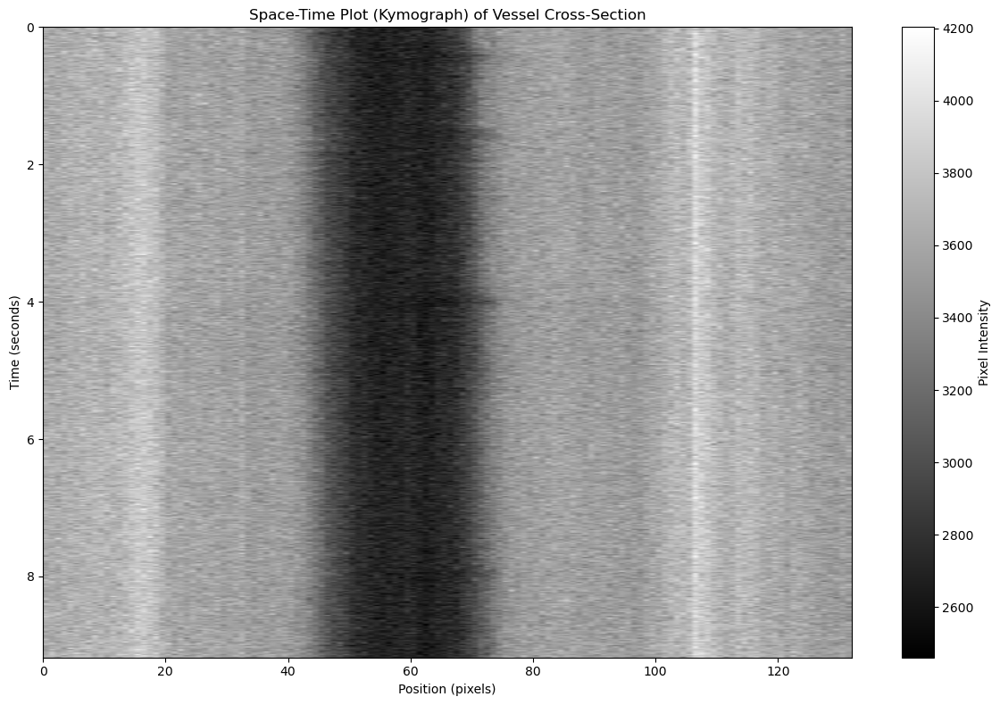

In [11]:
# Create a space-time plot (kymograph) by taking a cross-section through the vessel
# Take the middle row of each frame
mid_row = movie_data.data.shape[1] // 2
time_samples = 500  # Use a subset of frames for better visualization

# Extract the cross-sectional line from each frame
cross_section = movie_data.data[:time_samples, mid_row, :]

plt.figure(figsize=(12, 8))
plt.imshow(cross_section, aspect='auto', cmap='gray', 
           extent=[0, movie_data.data.shape[2], time_samples/movie_data.rate, 0])
plt.title('Space-Time Plot (Kymograph) of Vessel Cross-Section')
plt.xlabel('Position (pixels)')
plt.ylabel('Time (seconds)')
plt.colorbar(label='Pixel Intensity')
plt.tight_layout()
plt.show()

This space-time plot (kymograph) shows how the vessel cross-section changes over time. The vertical axis represents time, and the horizontal axis represents position across the vessel. The darker region corresponds to the vessel, and variations in its width indicate changes in vessel diameter due to pulsatility.

## Creating an Animation to Visualize Vessel Pulsations

Let's create a short animation to better visualize the vessel pulsations.

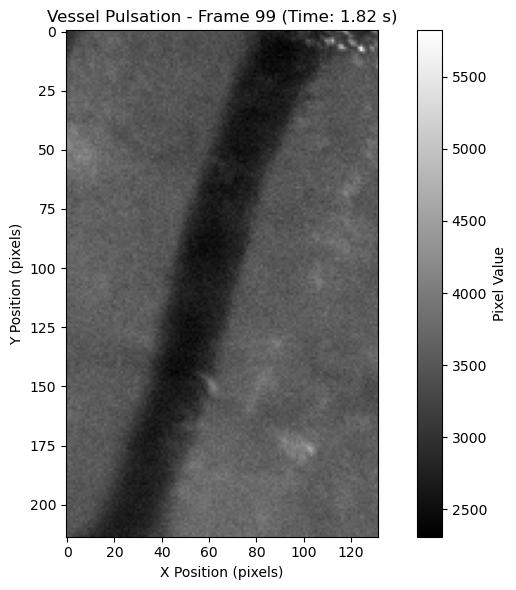

In [12]:
# Create an animation of a subset of frames
num_frames = 100  # Use 100 frames for the animation

# Initialize the figure
fig, ax = plt.subplots(figsize=(8, 6))
frame = movie_data.data[0, :, :]
im = ax.imshow(frame, cmap='gray')
plt.colorbar(im, ax=ax, label='Pixel Value')
ax.set_title('Vessel Pulsation Animation')
ax.set_xlabel('X Position (pixels)')
ax.set_ylabel('Y Position (pixels)')

# Animation update function
def update(frame_idx):
    frame = movie_data.data[frame_idx, :, :]
    im.set_array(frame)
    ax.set_title(f'Vessel Pulsation - Frame {frame_idx} (Time: {frame_idx/movie_data.rate:.2f} s)')
    return [im]

# Create animation
ani = FuncAnimation(fig, update, frames=range(0, num_frames), blit=True)
plt.tight_layout()

# Display the animation
from IPython.display import HTML
HTML(ani.to_jshtml())

This animation shows how the vessel appearance changes over time due to pulsations, which is useful for qualitative assessment of vessel dynamics.

## Analyzing Vessel Cross-Section Profile

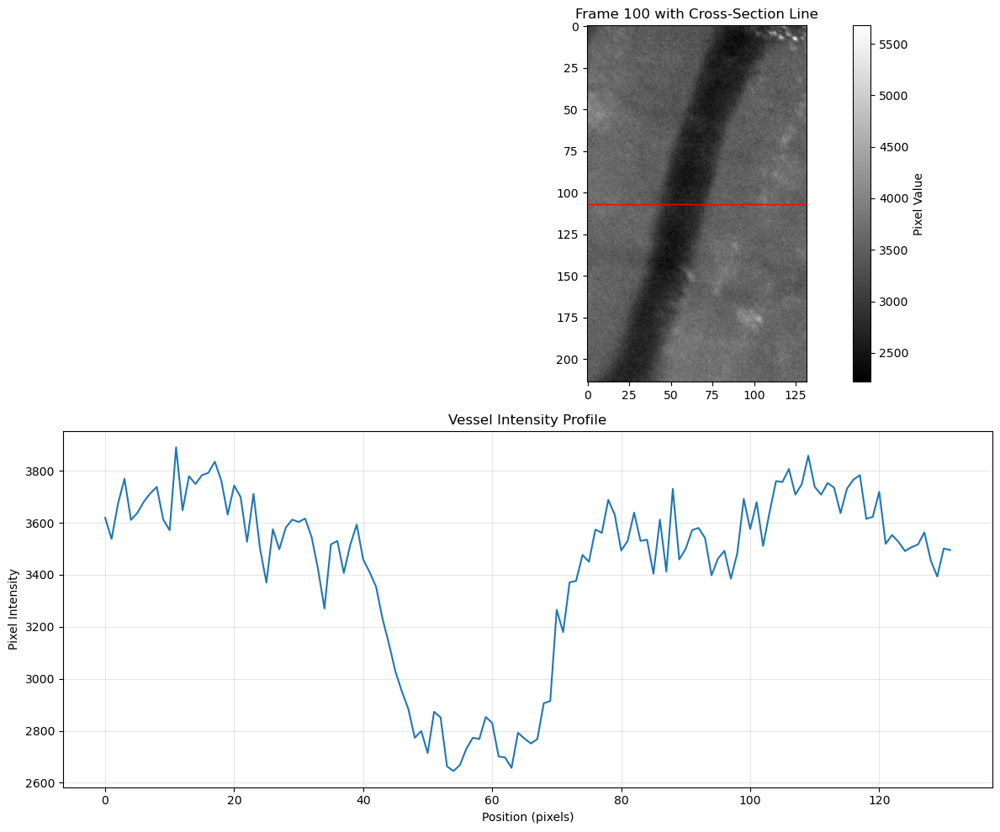

In [13]:
# Extract a single frame to analyze vessel cross-section
frame_idx = 100
frame = movie_data.data[frame_idx, :, :]

# Get intensity profile across the middle of the image
mid_row = frame.shape[0] // 2
intensity_profile = frame[mid_row, :]

# Plot the original image with a line showing where the profile is taken
plt.figure(figsize=(12, 10))

plt.subplot(2, 1, 1)
plt.imshow(frame, cmap='gray')
plt.axhline(y=mid_row, color='r', linestyle='-', linewidth=1)
plt.title(f'Frame {frame_idx} with Cross-Section Line')
plt.colorbar(label='Pixel Value')

# Plot the intensity profile
plt.subplot(2, 1, 2)
plt.plot(intensity_profile)
plt.title('Vessel Intensity Profile')
plt.xlabel('Position (pixels)')
plt.ylabel('Pixel Intensity')
plt.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

This analysis shows the intensity profile across the vessel. The dip in intensity corresponds to the vessel location, and the width of this dip could be used to estimate vessel diameter using techniques like the full width at half maximum (FWHM) method mentioned in the dataset description.

## Conclusion

In this notebook, we explored Dandiset 001366, which contains imaging data of pial vessels in mice for analyzing vessel diameter and pulsatility. We accessed the data remotely using the DANDI API and pynwb libraries, examined various metadata, and visualized the image data.

Some potential future directions for analysis include:

- Implementing vessel diameter measurement techniques such as Radon transform and FWHM
- Quantifying vessel pulsatility and correlating it with physiological parameters
- Comparing measurements across different subjects and experimental conditions
- Developing automated tools to track vessel properties over time